In [1]:
df = pd.read_excel('supply.xlsx')

In [240]:
import hangul_font

Hangul font is set!


### 일자별 행정동별 카테고리별 물류 건수
- 기준지역 내 일자별 카테고리별 물류 건수
- 특기사항:
    - 기간: 190201~190531, 20200201~20200531
    - 지역: 대구(수성구, 중구), 서울(노원구, 중구) 내 전 행정동
    - 카테고리별(대분류기준) 송장 건수

- DL_YMD : 배송년원일
- DL_GD_LCLS_NM : 배송상품대분류명
- DL_GD_LCLS_CD :배송상품대분류코드
- CTPV_NM : 시도명
- CTPV_CD : 시도코드
- CTGG_NM : 시군구명
- CTGG_CD : 시군구코드
- HDNG_NM : 행정동명
- HDNG_CD : 행정동코드
- INV_CONT : 송정건수

In [2]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156571 entries, 0 to 156570
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   DL_YMD         156571 non-null  int64 
 1   DL_GD_LCLS_NM  156571 non-null  object
 2   DL_GD_LCLS_CD  156571 non-null  int64 
 3   CTPV_NM        156571 non-null  object
 4   CTPV_CD        156571 non-null  int64 
 5   CTGG_NM        156571 non-null  object
 6   CTGG_CD        156571 non-null  int64 
 7   HDNG_NM        156571 non-null  object
 8   HDNG_CD        156571 non-null  int64 
 9   INVC_CONT      156571 non-null  int64 
dtypes: int64(6), object(4)
memory usage: 11.9+ MB


- 10	가구/인테리어: 거실가구, 아동가구, 주방가구, 침실가구
- 12	도서/음반:	도서/음반
- 13	디지털/가전: 계절가전, 광학기기, 생활가전, 이미용가전, 주방가전, 자동차기기
- 15	생활건강: 건강관리/건강측정, 문구/사무용품, 생활용품, 욕실용품, 주방용품, 수납정리용품, 애완
- 16	스포츠/레져: 검도, 골프, 권투, 낚시, 농구, 등산, 배드민턴, 야구, 축구, 캠핑
- 17	식품: 가공식품, 건강식품, 신선식품, 반찬, 과자/간식/음료
- 18	출산/육아: 기저귀, 분유/이유식, 수유용품, 유아용품
- 19	패션의류: 의류, 언더웨어
- 20	패션잡화: 가방/지갑, 신발, 악세서리
- 21	화장품/미용: 기초화장품, 색조화장품, 바디용품, 헤어용품, 뷰티소품, 향수

In [3]:
df.tail()

,DL_YMD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTPV_CD,CTGG_NM,CTGG_CD,HDNG_NM,HDNG_CD,INVC_CONT
156566,200531,패션의류,19,대구광역시,27,수성구,26,범물2동,662,22
156567,200531,패션의류,19,서울특별시,11,중구,14,약수동,635,21
156568,200531,패션잡화,20,대구광역시,27,수성구,26,범물2동,662,14
156569,200531,패션잡화,20,서울특별시,11,노원구,35,상계6.7동,695,25
156570,200531,화장품/미용,21,대구광역시,27,수성구,26,수성4가동,590,27


In [26]:
### 1. 년도별로 먼저 나눠주기
df.loc[df['DL_YMD'] == 200201]

,DL_YMD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTPV_CD,CTGG_NM,CTGG_CD,HDNG_NM,HDNG_CD,INVC_CONT
76892,200201,가구/인테리어,10,대구광역시,27,수성구,26,범어3동,530,3
76893,200201,도서/음반,12,서울특별시,11,노원구,35,월계1동,560,24
76894,200201,가구/인테리어,10,대구광역시,27,수성구,26,범물2동,662,3
76895,200201,가구/인테리어,10,서울특별시,11,노원구,35,상계3.4동,665,4
76896,200201,도서/음반,12,대구광역시,27,수성구,26,수성1가동,570,34
...,...,...,...,...,...,...,...,...,...,...
77494,200201,화장품/미용,21,대구광역시,27,수성구,26,상동,620,20
77495,200201,출산/육아,18,대구광역시,27,수성구,26,황금1동,601,2
77496,200201,화장품/미용,21,서울특별시,11,노원구,35,월계2동,570,29
77497,200201,패션잡화,20,서울특별시,11,노원구,35,월계1동,560,9


In [19]:
df.iloc[76892:]

,DL_YMD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTPV_CD,CTGG_NM,CTGG_CD,HDNG_NM,HDNG_CD,INVC_CONT
76894,200201,가구/인테리어,10,대구광역시,27,수성구,26,범물2동,662,3
76895,200201,가구/인테리어,10,서울특별시,11,노원구,35,상계3.4동,665,4
76896,200201,도서/음반,12,대구광역시,27,수성구,26,수성1가동,570,34
76897,200201,디지털/가전,13,서울특별시,11,노원구,35,상계6.7동,695,23
76898,200201,디지털/가전,13,대구광역시,27,수성구,26,만촌1동,550,14
...,...,...,...,...,...,...,...,...,...,...
156566,200531,패션의류,19,대구광역시,27,수성구,26,범물2동,662,22
156567,200531,패션의류,19,서울특별시,11,중구,14,약수동,635,21
156568,200531,패션잡화,20,대구광역시,27,수성구,26,범물2동,662,14
156569,200531,패션잡화,20,서울특별시,11,노원구,35,상계6.7동,695,25


In [27]:
df_19 = df.iloc[:76892].copy()
df_20 = df.iloc[76892:].copy()

In [36]:
# 시도코드 & 시군구코드를 묶어서 새로운 컬럼 생성
# 서울 중구 : '1114'
# 서울 중구 : '1135'
# 대구 중구 : '2711'
# 대구 수성구 : '2726'

df_19['CD'] = df_19.CTPV_CD.astype('str')\
+ df_19.CTGG_CD.astype('str')
df_20['CD'] = df_20.CTPV_CD.astype('str')\
+ df_20.CTGG_CD.astype('str')

In [59]:
# 시간에 따라 구역별 송정건수 관찰
# 같은 일지별 송정건수를 구역별 통합해줘야한다
# 동시에 같은 배송상품대분류코드끼리 묶어줘야한다


# cds = ['1135', '1114', '2711', '2726']
# DL_GD_LCLS_CD = [12, 10, 13, 16, 20, 17, 15, 19, 21, 18]

10

In [74]:
# 송정건수는 작년에 비해 늘었다
df_19['INVC_CONT'].sum(), df_20['INVC_CONT'].sum()

(7663651, 10161823)

In [85]:
aggregation_functions = {'INVC_CONT': 'sum'}
_19 = df_19_.groupby(df_19_['CD']).aggregate(aggregation_functions)
_19

,INVC_CONT
CD,
1114,1646201
1135,2942510
2711,716910
2726,2358030


In [83]:
aggregation_functions = {'INVC_CONT': 'sum'}
_20 = df_20_.groupby(df_20_['CD']).aggregate(aggregation_functions)
_20

,INVC_CONT
CD,
1114,1973815
1135,3869442
2711,875783
2726,3442783


In [91]:
data = pd.merge(_19, _20, on='CD')
data.rename(columns={'INVC_CONT_x':'19', 'INVC_CONT_y':'20'}, inplace=True)

In [97]:
data

,19,20
CD,,
1114,1646201,1973815
1135,2942510,3869442
2711,716910,875783
2726,2358030,3442783


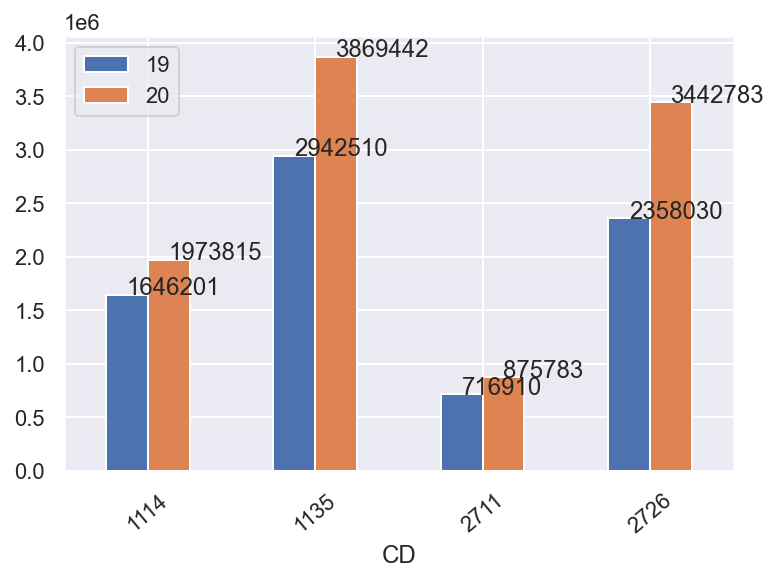

In [98]:
fig, ax = plt.subplots()
data.plot.bar( y = ['19', '20'], rot = 40, ax = ax)
for p in ax.patches: 
    ax.annotate(np.round(p.get_height()), (p.get_x()+p.get_width()/2., p.get_height()))


In [257]:
df_19_ = df_19.groupby(['DL_YMD', 'CD','DL_GD_LCLS_NM', "DL_GD_LCLS_CD","CTPV_NM", "CTGG_NM"])['INVC_CONT'].sum().reset_index()
df_19_

,DL_YMD,CD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTGG_NM,INVC_CONT
0,190201,1114,가구/인테리어,10,서울특별시,중구,45
1,190201,1114,도서/음반,12,서울특별시,중구,340
2,190201,1114,디지털/가전,13,서울특별시,중구,251
3,190201,1114,생활건강,15,서울특별시,중구,284
4,190201,1114,스포츠/레저,16,서울특별시,중구,14
...,...,...,...,...,...,...,...
4725,190531,2726,식품,17,대구광역시,수성구,4516
4726,190531,2726,출산/육아,18,대구광역시,수성구,123
4727,190531,2726,패션의류,19,대구광역시,수성구,4715
4728,190531,2726,패션잡화,20,대구광역시,수성구,1537


In [386]:
aggregation_functions = {'INVC_CONT': 'sum'}
_20_ = df_20_.groupby(['DL_YMD','CD'])['INVC_CONT'].sum().reset_index()
# _20_["DL_YMD"] = _20_["DL_YMD"].astype("str")
# _20_["DL_YMD"] = _20_["DL_YMD"].apply(lambda x : x[2:6])

In [387]:
_20_

,DL_YMD,CD,INVC_CONT
0,20200201,1114,3480
1,20200201,1135,5489
2,20200201,2711,1184
3,20200201,2726,4337
4,20200202,1114,2439
...,...,...,...
479,20200530,2726,3902
480,20200531,1114,1518
481,20200531,1135,3503
482,20200531,2711,689


In [388]:
_20_.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 484 entries, 0 to 483
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   DL_YMD     484 non-null    object
 1   CD         484 non-null    object
 2   INVC_CONT  484 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 11.5+ KB


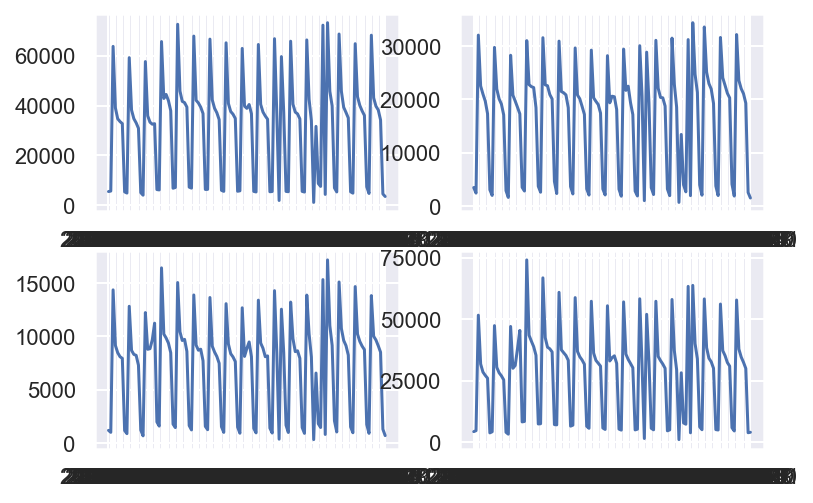

In [389]:
for i, cd in zip(range(1,5), cds):
    plt.subplot(2,2,i)
    plt.plot(_20_[_20_['CD'] == cd].DL_YMD, _20_[_20_['CD'] == cd].INVC_CONT)

In [ ]:
aggregation_functions = {'INVC_CONT': 'sum'}
_20_ = df_20_.groupby(['DL_YMD','CD'])['INVC_CONT'].sum().reset_index()
_20_["DL_YMD"] = _20_["DL_YMD"].astype("str")
_20_["DL_YMD"] = _20_["DL_YMD"].apply(lambda x : x[2:6])

In [286]:
df_20_ = df_20.groupby(['DL_YMD', 'CD','DL_GD_LCLS_NM', "DL_GD_LCLS_CD","CTPV_NM", "CTGG_NM"])['INVC_CONT'].sum().reset_index()
df_20_

,DL_YMD,CD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTGG_NM,INVC_CONT
0,200201,1114,가구/인테리어,10,서울특별시,중구,53
1,200201,1114,도서/음반,12,서울특별시,중구,417
2,200201,1114,디지털/가전,13,서울특별시,중구,178
3,200201,1114,생활건강,15,서울특별시,중구,675
4,200201,1114,스포츠/레저,16,서울특별시,중구,19
...,...,...,...,...,...,...,...
4819,200531,2726,식품,17,대구광역시,수성구,794
4820,200531,2726,출산/육아,18,대구광역시,수성구,5
4821,200531,2726,패션의류,19,대구광역시,수성구,683
4822,200531,2726,패션잡화,20,대구광역시,수성구,328


In [293]:
df_19_ = df_19.groupby(['DL_YMD', 'CD','DL_GD_LCLS_NM', "DL_GD_LCLS_CD","CTPV_NM", "CTGG_NM"])['INVC_CONT'].sum().reset_index()
df_19_

,DL_YMD,CD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTGG_NM,INVC_CONT
0,190201,1114,가구/인테리어,10,서울특별시,중구,45
1,190201,1114,도서/음반,12,서울특별시,중구,340
2,190201,1114,디지털/가전,13,서울특별시,중구,251
3,190201,1114,생활건강,15,서울특별시,중구,284
4,190201,1114,스포츠/레저,16,서울특별시,중구,14
...,...,...,...,...,...,...,...
4725,190531,2726,식품,17,대구광역시,수성구,4516
4726,190531,2726,출산/육아,18,대구광역시,수성구,123
4727,190531,2726,패션의류,19,대구광역시,수성구,4715
4728,190531,2726,패션잡화,20,대구광역시,수성구,1537


In [276]:
import datetime

In [287]:
df_20_["DL_YMD"] = df_20_["DL_YMD"].astype("str")
df_20_["DL_YMD"] = df_20_["DL_YMD"].apply(lambda x: '20' + x)

In [294]:
df_19_["DL_YMD"] = df_19_["DL_YMD"].astype("str")
df_19_["DL_YMD"] = df_19_["DL_YMD"].apply(lambda x: '20' + x)

In [390]:
for dfs in [df_19_, df_20_]:
    ls = list(dfs['DL_YMD'])
    ls_1 = list(map(lambda x: x[0:4], ls)) # 년
    ls_2 = list(map(lambda x: x[4:6], ls)) # 월
    ls_3 = list(map(lambda x: x[6:8], ls)) # 일

    ls_1 = list(map(int, ls_1))
    ls_2 = list(map(int, ls_2))
    ls_3 = list(map(int, ls_3))
    ls_4 = list(map(lambda x, y, z: datetime.date(x, y, z).weekday(), ls_1, ls_2, ls_3))

    ls_week=[]
    for x in ls_4:
        if x == 0:
            ls_week.append("월")
        elif x == 1:
            ls_week.append("화")
        elif x == 2:
            ls_week.append("수")
        elif x == 3:
            ls_week.append("목")
        elif x == 4:
            ls_week.append("금")
        elif x == 5:
            ls_week.append("토")
        elif x == 6:
            ls_week.append("일")
    dfs["week"] = ls_week        

In [296]:
weekdays = ['월', '화', '수', '목', '금']
weekends = ['토', '일']

In [391]:
# df_20_['week'] == '토'
indexnames1 = df_20_[df_20_['week'] == '토'].index
indexnames2 = df_20_[df_20_['week'] == '일'].index
df_20_wd = df_20_.drop(indexnames1)
df_20_wd = df_20_wd.drop(indexnames2)
df_20_wd.reset_index(inplace=True, drop=True)
df_20_wd

,DL_YMD,CD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTGG_NM,INVC_CONT,week
0,20200203,1114,가구/인테리어,10,서울특별시,중구,943,월
1,20200203,1114,도서/음반,12,서울특별시,중구,1378,월
2,20200203,1114,디지털/가전,13,서울특별시,중구,2709,월
3,20200203,1114,생활건강,15,서울특별시,중구,7652,월
4,20200203,1114,스포츠/레저,16,서울특별시,중구,313,월
...,...,...,...,...,...,...,...,...
3391,20200529,2726,식품,17,대구광역시,수성구,6317,금
3392,20200529,2726,출산/육아,18,대구광역시,수성구,146,금
3393,20200529,2726,패션의류,19,대구광역시,수성구,6946,금
3394,20200529,2726,패션잡화,20,대구광역시,수성구,2368,금


In [392]:
# df_19_['week'] == '토'
indexnames1 = df_19_[df_19_['week'] == '토'].index
indexnames2 = df_19_[df_19_['week'] == '일'].index
df_19_wd = df_19_.drop(indexnames1)
df_19_wd = df_19_wd.drop(indexnames2)
df_19_wd.reset_index(inplace=True, drop=True)
df_19_wd

,DL_YMD,CD,DL_GD_LCLS_NM,DL_GD_LCLS_CD,CTPV_NM,CTGG_NM,INVC_CONT,week
0,20190201,1114,가구/인테리어,10,서울특별시,중구,45,금
1,20190201,1114,도서/음반,12,서울특별시,중구,340,금
2,20190201,1114,디지털/가전,13,서울특별시,중구,251,금
3,20190201,1114,생활건강,15,서울특별시,중구,284,금
4,20190201,1114,스포츠/레저,16,서울특별시,중구,14,금
...,...,...,...,...,...,...,...,...
3389,20190531,2726,식품,17,대구광역시,수성구,4516,금
3390,20190531,2726,출산/육아,18,대구광역시,수성구,123,금
3391,20190531,2726,패션의류,19,대구광역시,수성구,4715,금
3392,20190531,2726,패션잡화,20,대구광역시,수성구,1537,금


In [393]:
df_19_wd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3394 entries, 0 to 3393
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   DL_YMD         3394 non-null   object
 1   CD             3394 non-null   object
 2   DL_GD_LCLS_NM  3394 non-null   object
 3   DL_GD_LCLS_CD  3394 non-null   int64 
 4   CTPV_NM        3394 non-null   object
 5   CTGG_NM        3394 non-null   object
 6   INVC_CONT      3394 non-null   int64 
 7   week           3394 non-null   object
dtypes: int64(2), object(6)
memory usage: 212.2+ KB


In [396]:

range0:(len(x1)+len(x)):5]

SyntaxError: invalid syntax (<ipython-input-396-dbabe89fe90a>, line 1)

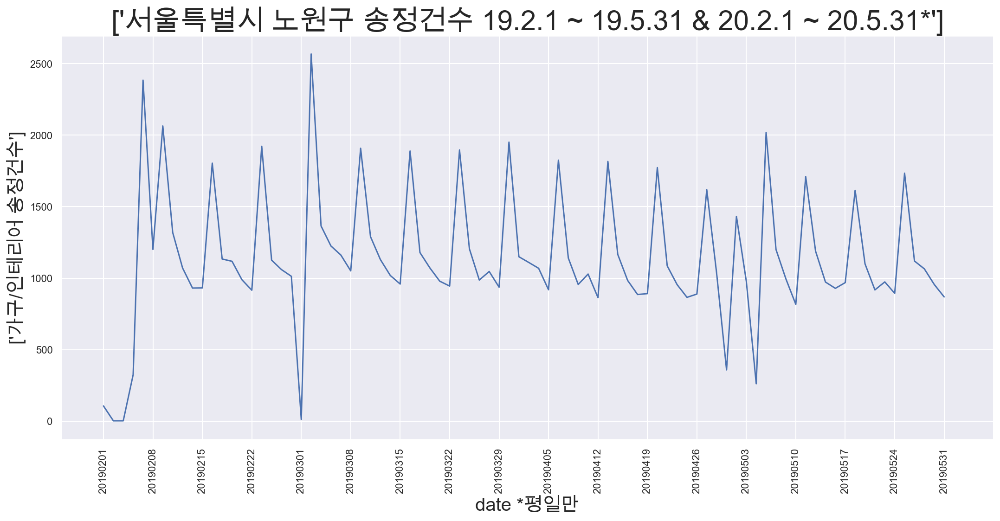

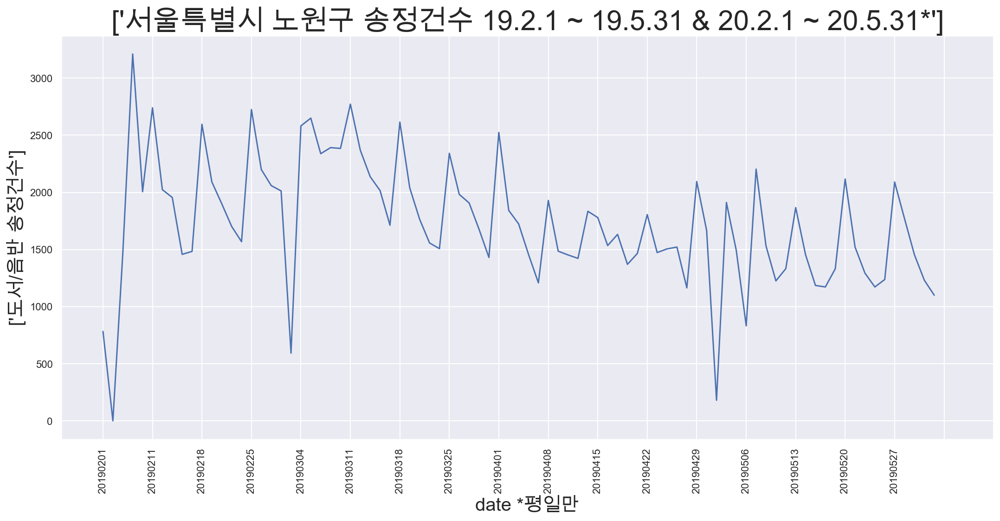

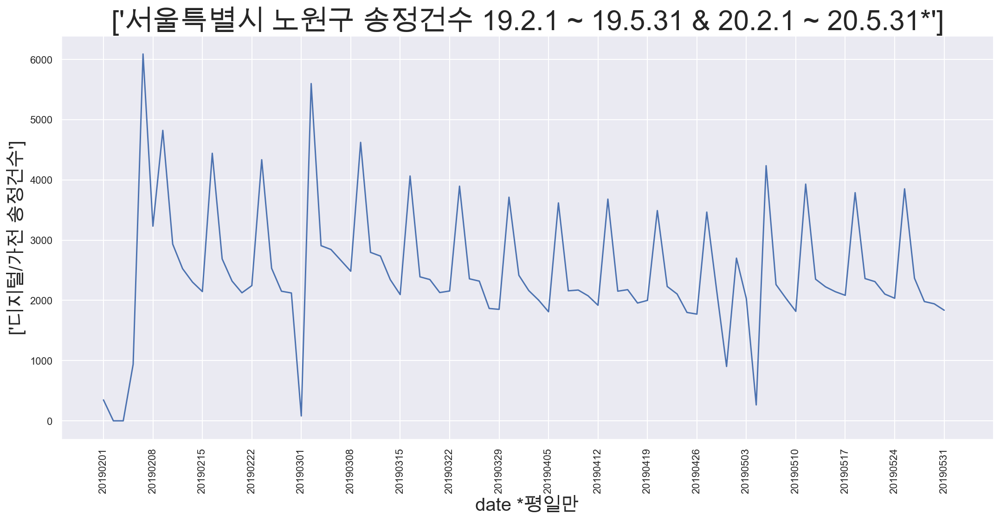

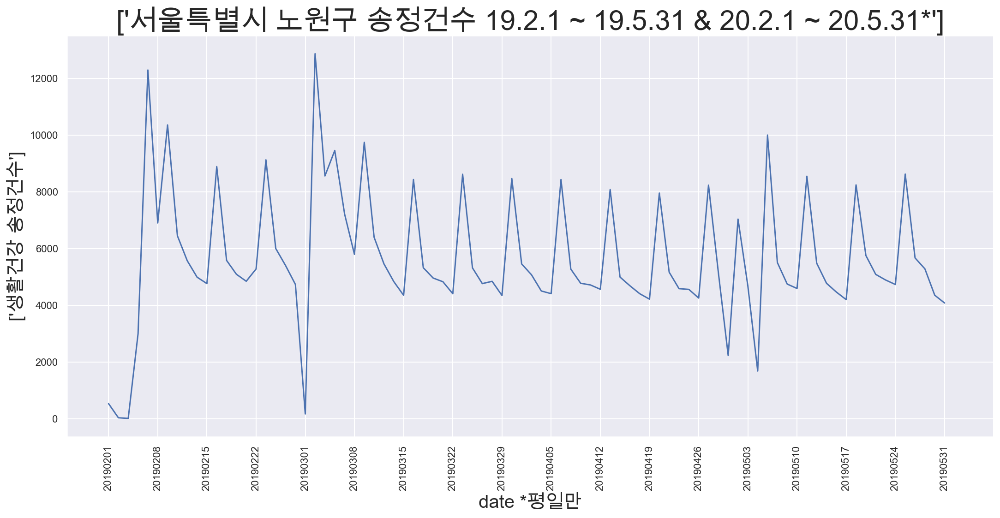

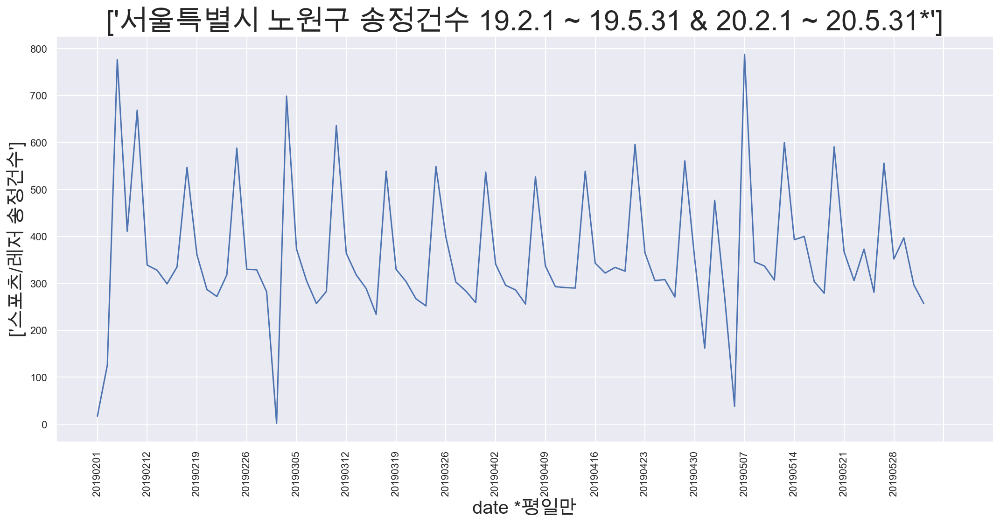

...

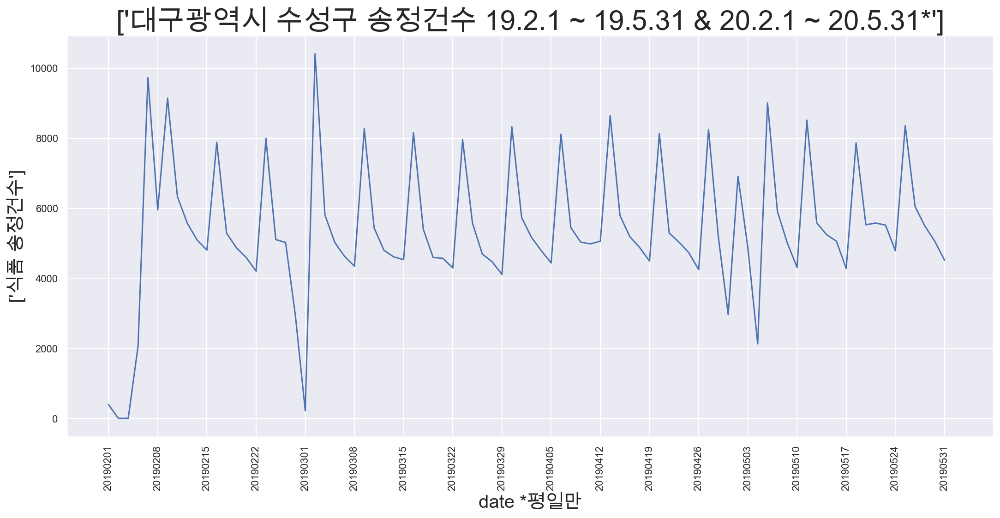

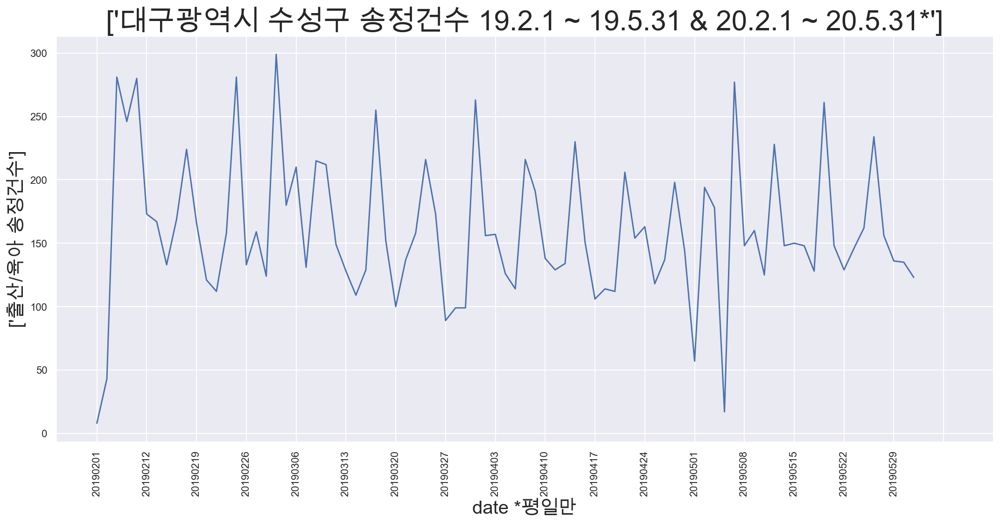

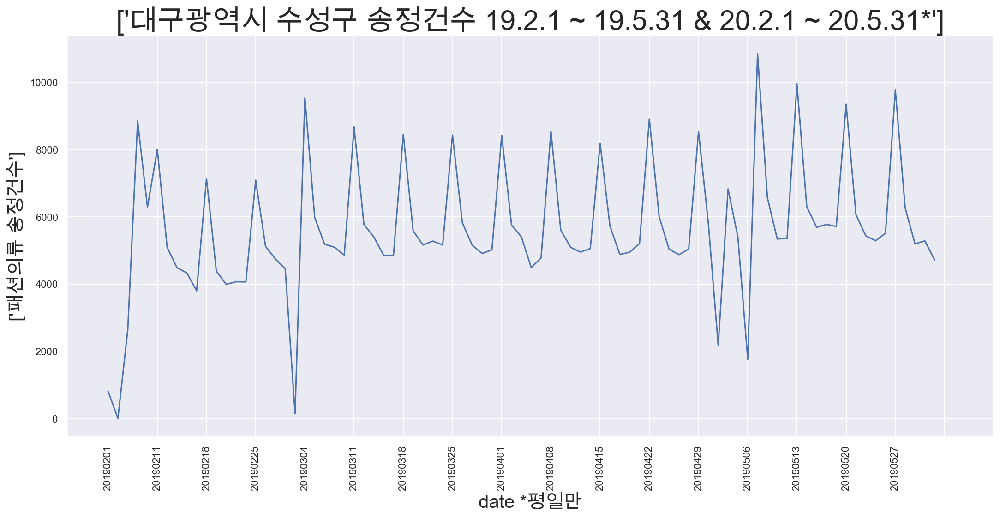

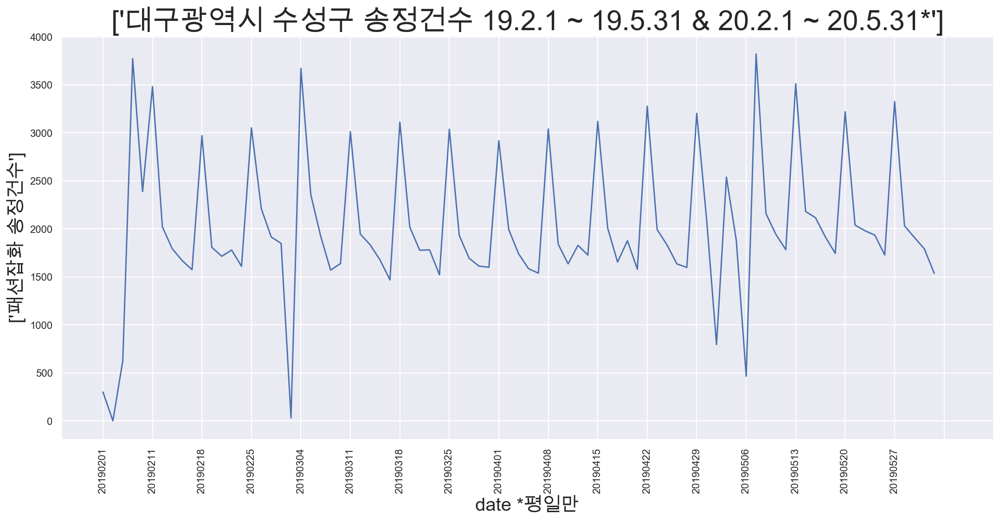

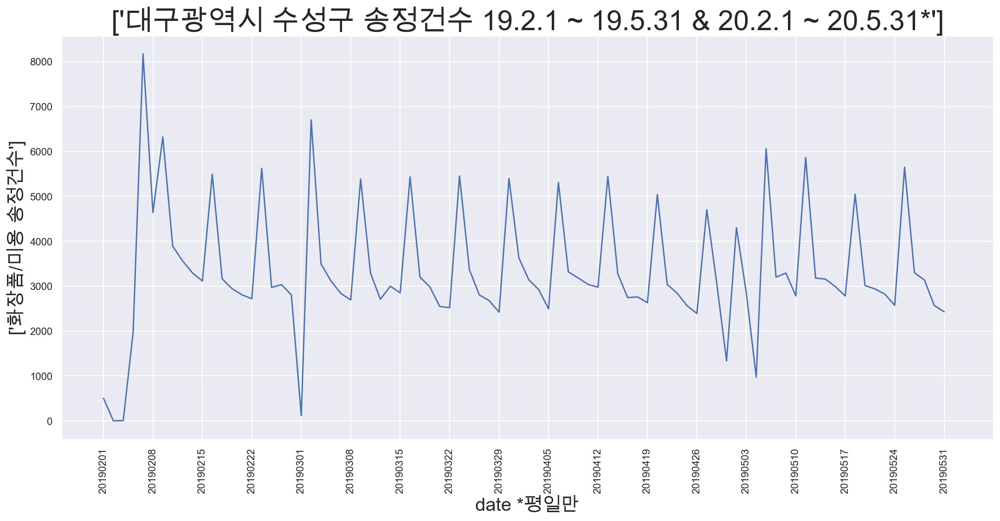

In [315]:
# 19년 구역 & 카테고리별로 나눠줬다
for cd1 in cds:
     for cd2 in (df_19_wd['DL_GD_LCLS_CD'].unique()):
            
            x = df_19_wd.loc[(df_19_wd['CD'] == cd1) & (df_19_wd['DL_GD_LCLS_CD'] == cd2)]
            plt.figure(figsize=(18,8))
            plt.plot(x.DL_YMD, x.INVC_CONT)
            plt.xlabel('date *평일만', fontsize=20)
            plt.ylabel(x.DL_GD_LCLS_NM.unique() + ' 송정건수', fontsize=20)
            plt.xticks([0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90], rotation=90)
            plt.title(x.CTPV_NM.unique() + " " + x.CTGG_NM.unique() + ' 송정건수 19.2.1 ~ 19.5.31*', fontsize=30)
            plt.show()
            

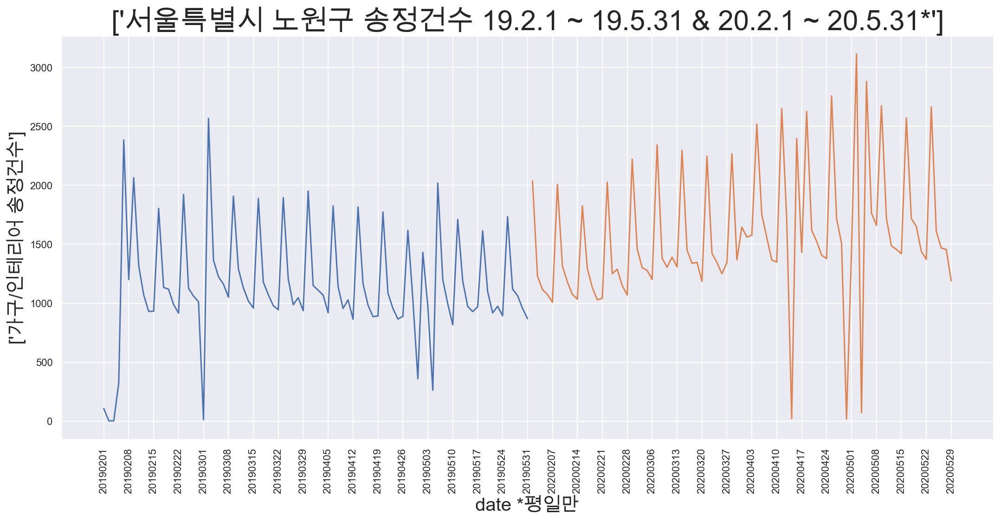

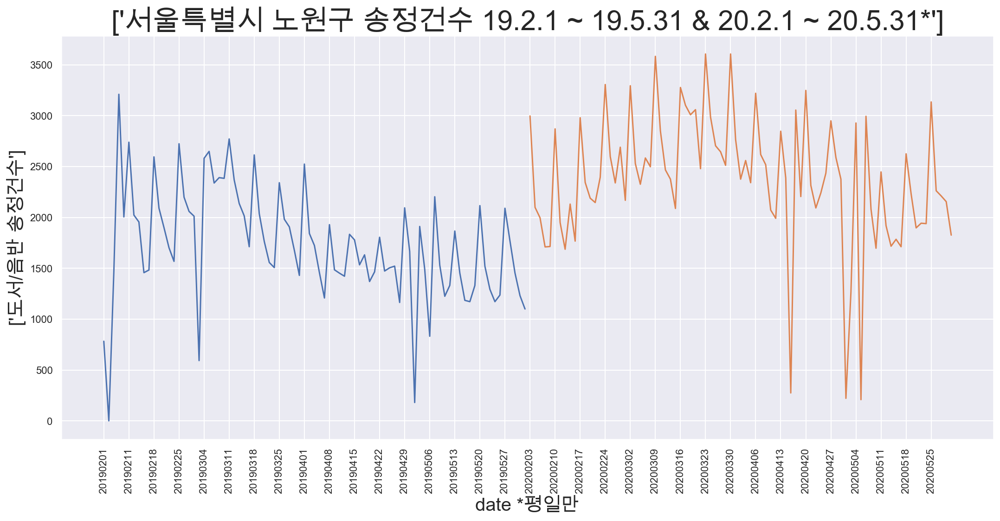

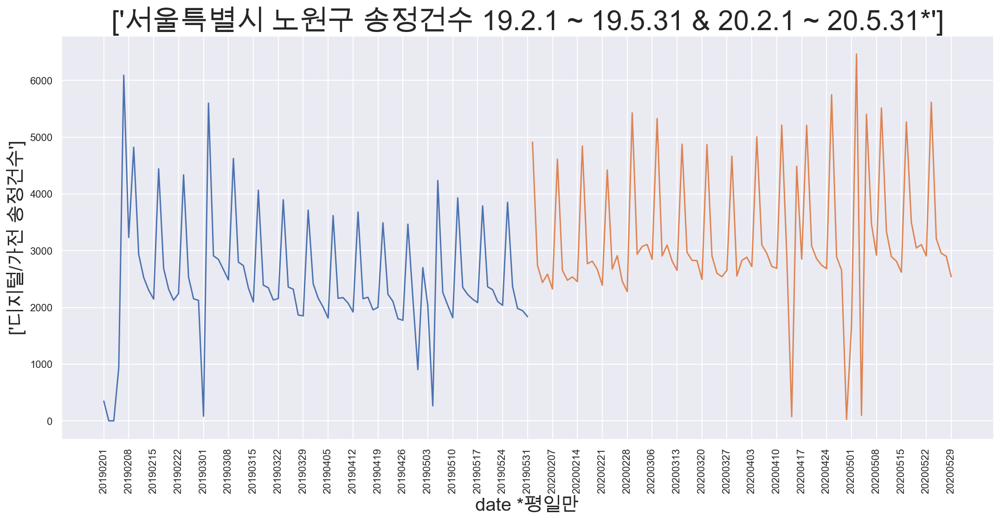

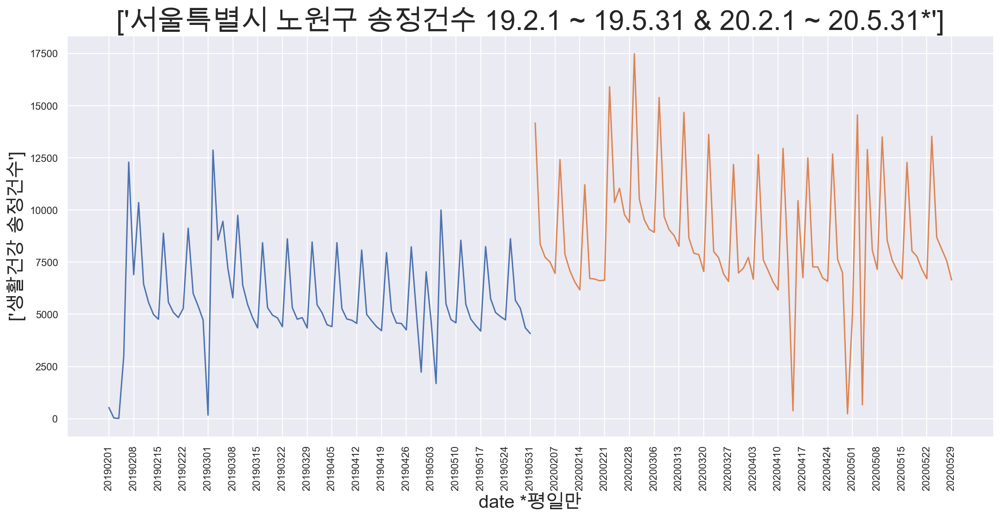

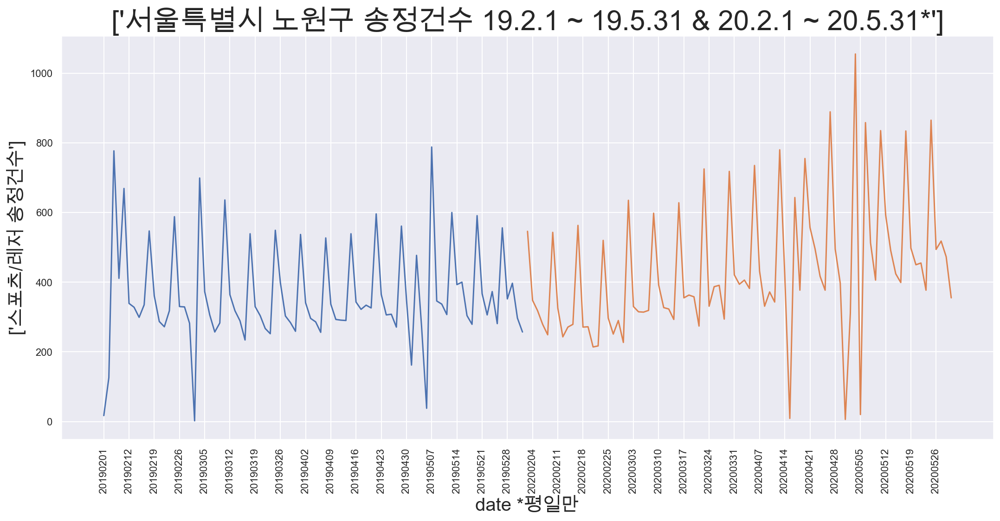

...

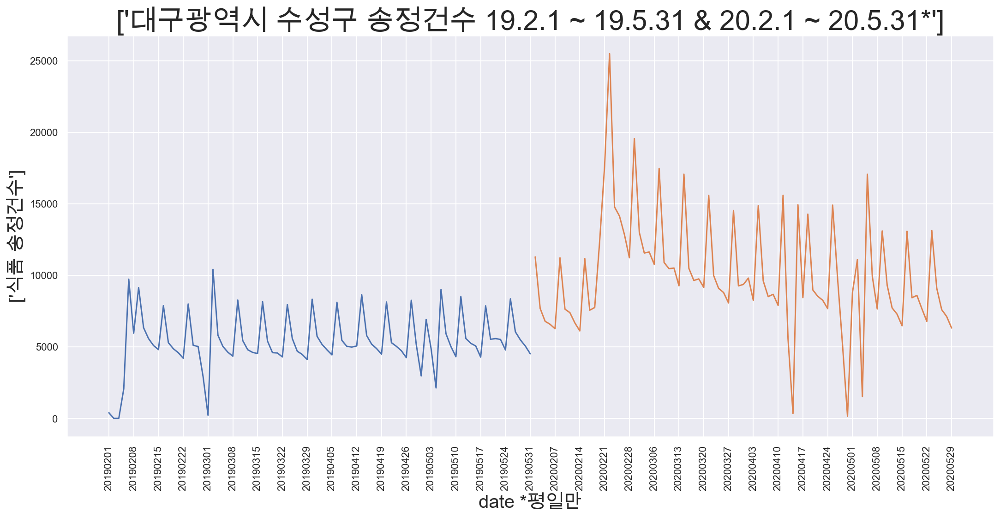

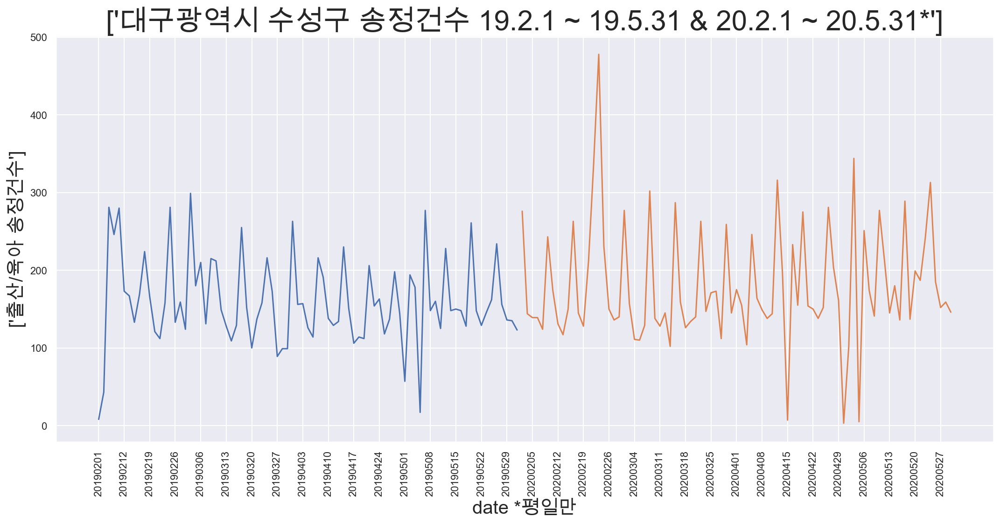

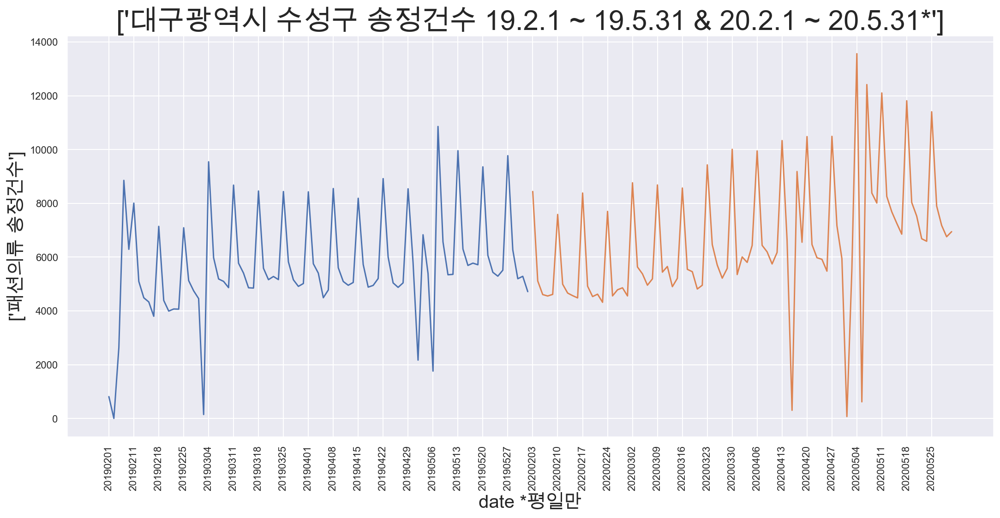

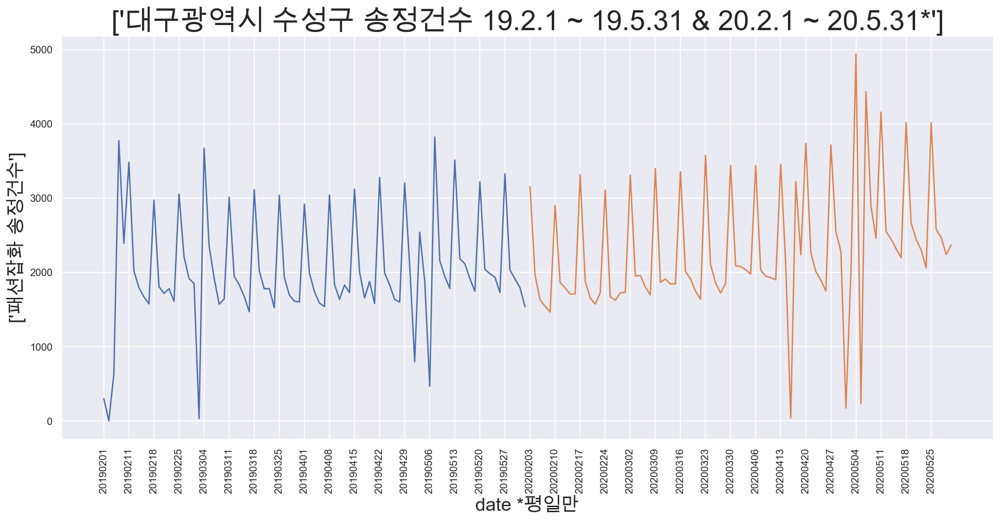

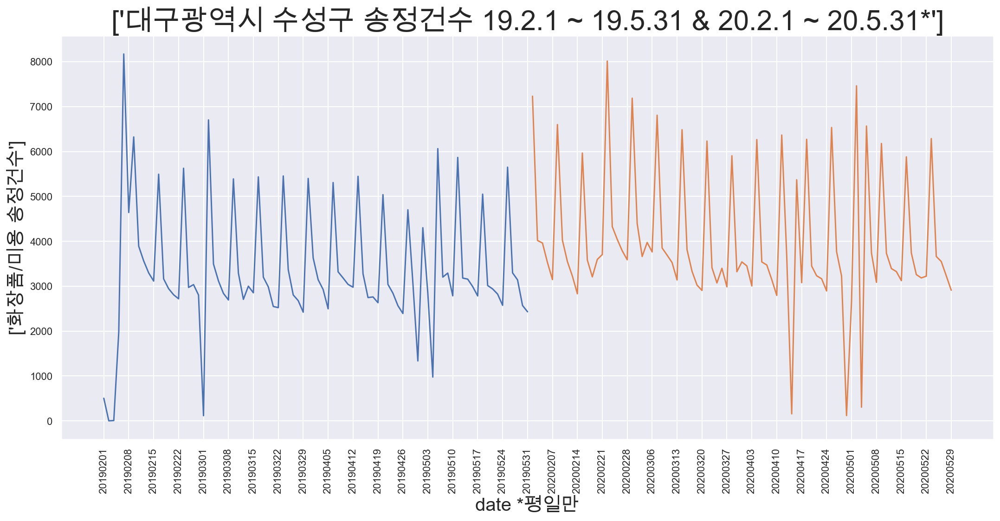

In [399]:
# 19년 구역 & 카테고리별로 나눠줬다
for cd1 in cds:
     for cd2, cd3 in zip((df_20_wd['DL_GD_LCLS_CD'].unique()), (df_19_wd['DL_GD_LCLS_CD'].unique())):
            
            x1 = df_19_wd.loc[(df_19_wd['CD'] == cd1) & (df_19_wd['DL_GD_LCLS_CD'] == cd3)]
            x = df_20_wd.loc[(df_20_wd['CD'] == cd1) & (df_20_wd['DL_GD_LCLS_CD'] == cd2)]
            
            plt.figure(figsize=(18,8))
            plt.plot(x1.DL_YMD, x1.INVC_CONT)
            plt.plot(x.DL_YMD, x.INVC_CONT)
            
            plt.xlabel('date *평일만', fontsize=20)
            plt.ylabel(x.DL_GD_LCLS_NM.unique() + ' 송정건수', fontsize=20)
            plt.xticks(range(0,(len(x1)+len(x)),5), rotation=90)
            plt.title(x.CTPV_NM.unique() + " " + x.CTGG_NM.unique() + ' 송정건수 19.2.1 ~ 19.5.31 & 20.2.1 ~ 20.5.31*', fontsize=30)
            plt.show()
            

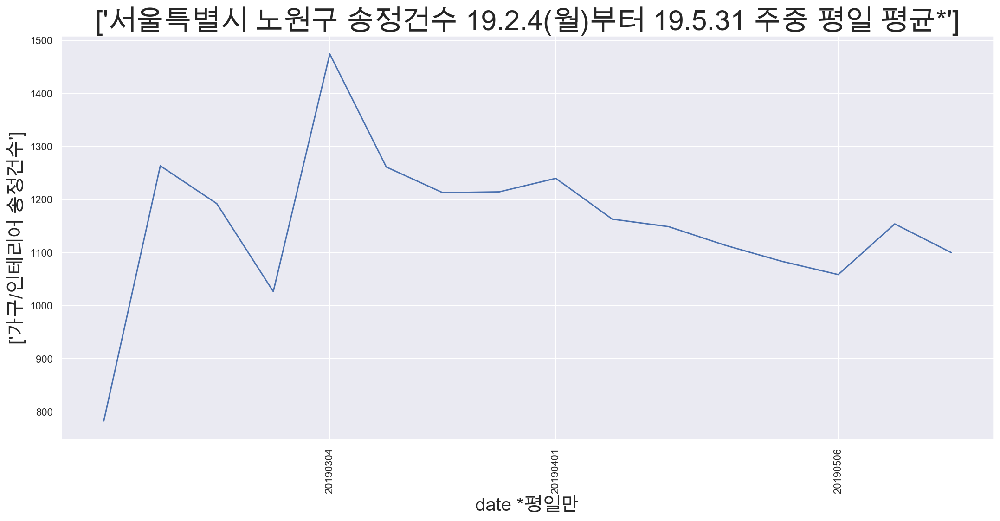

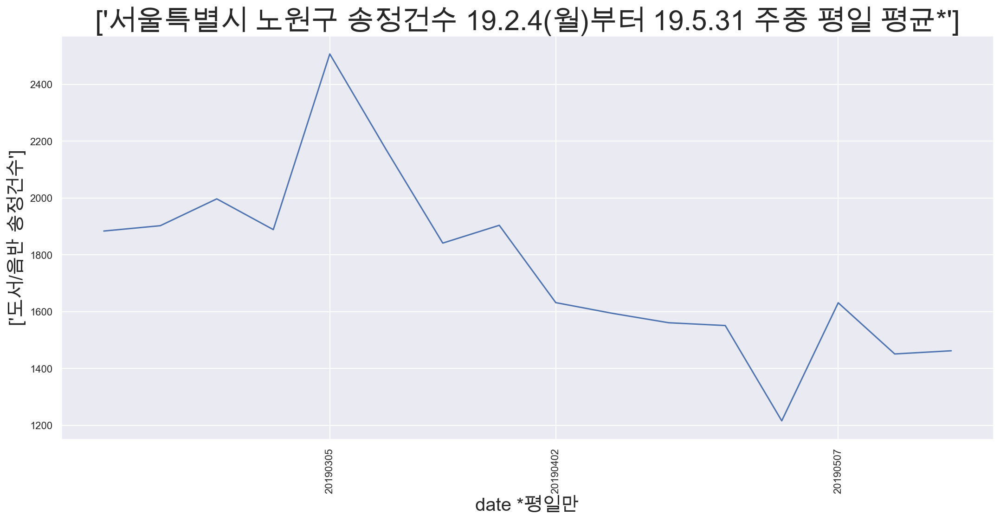

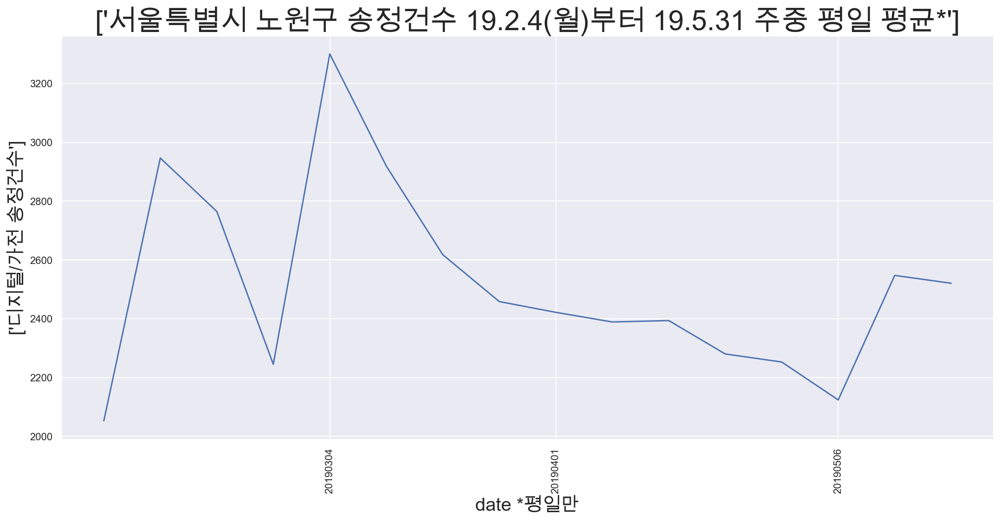

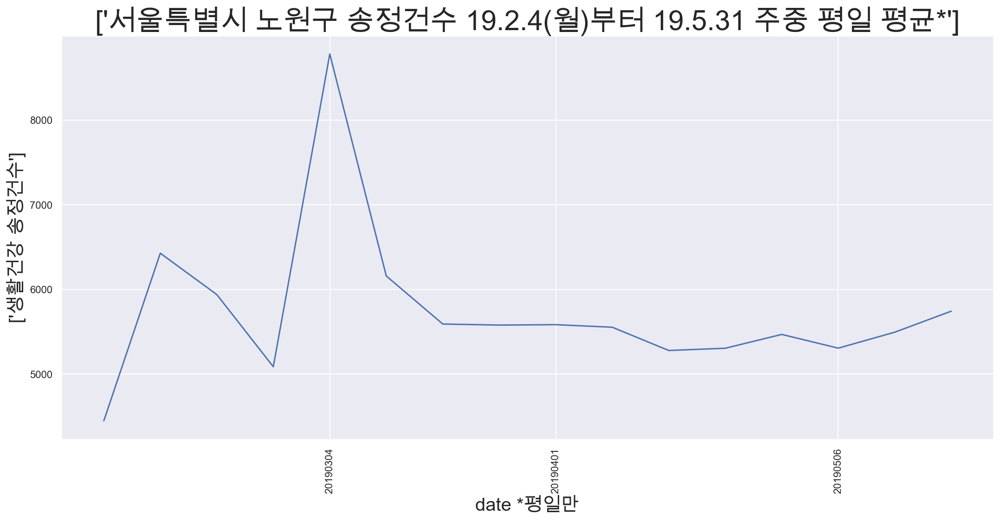

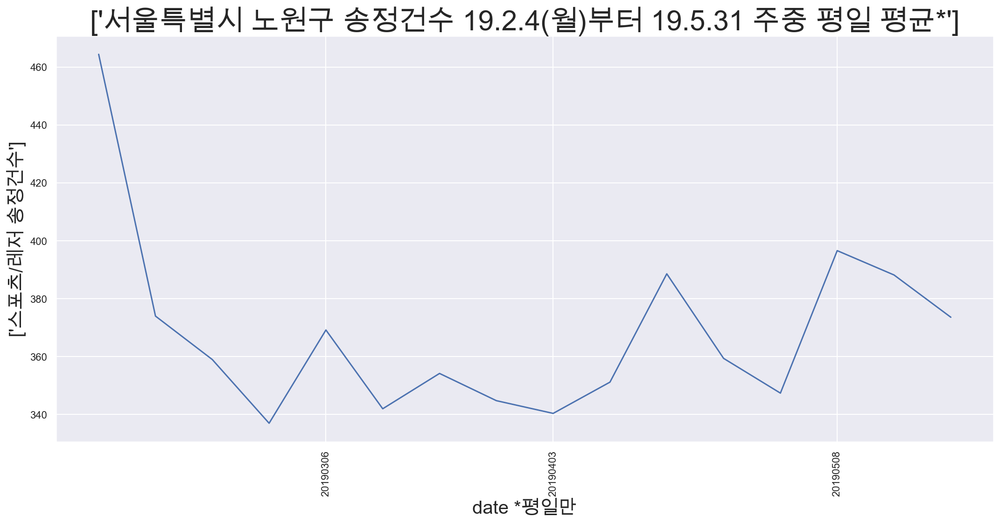

...

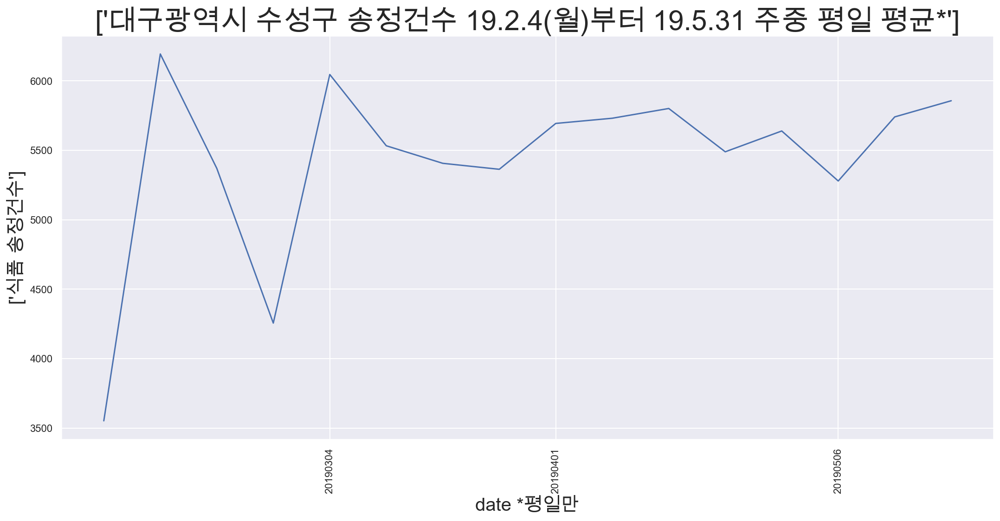

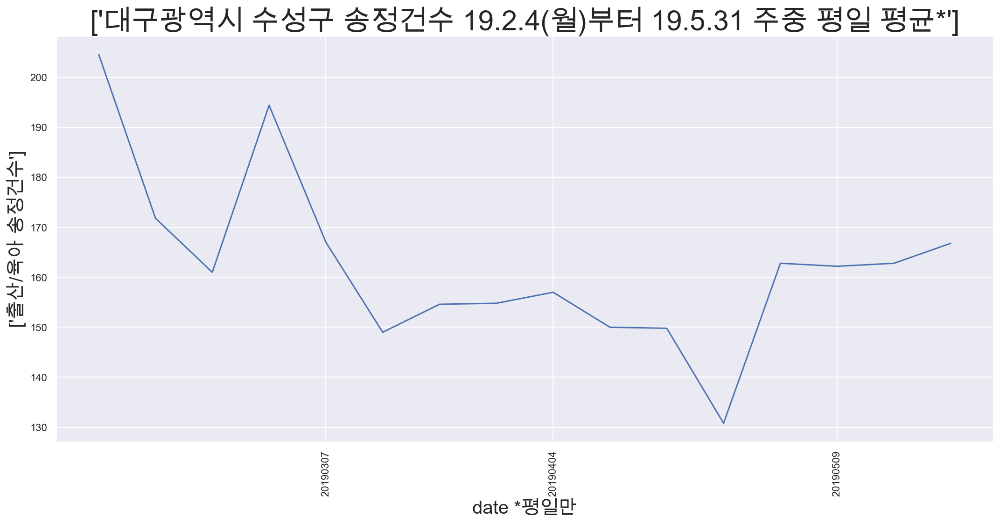

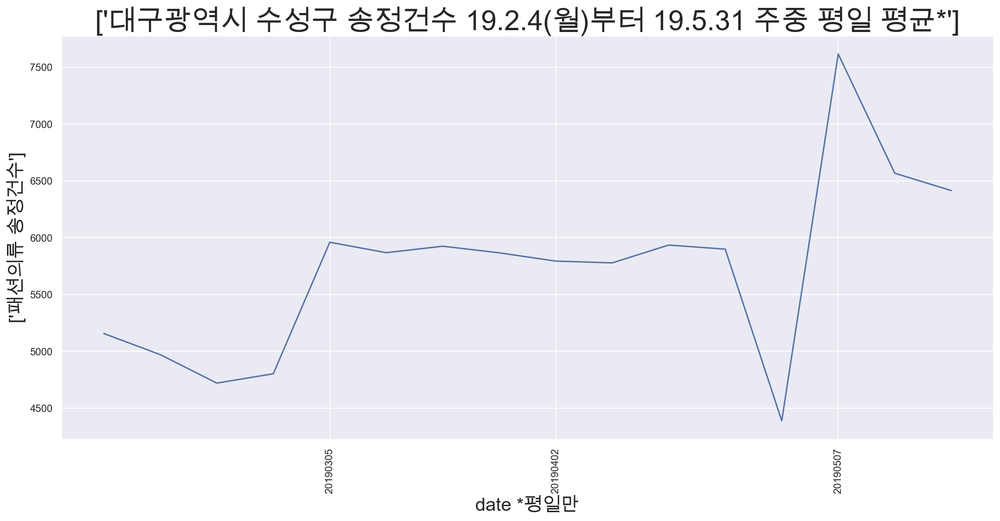

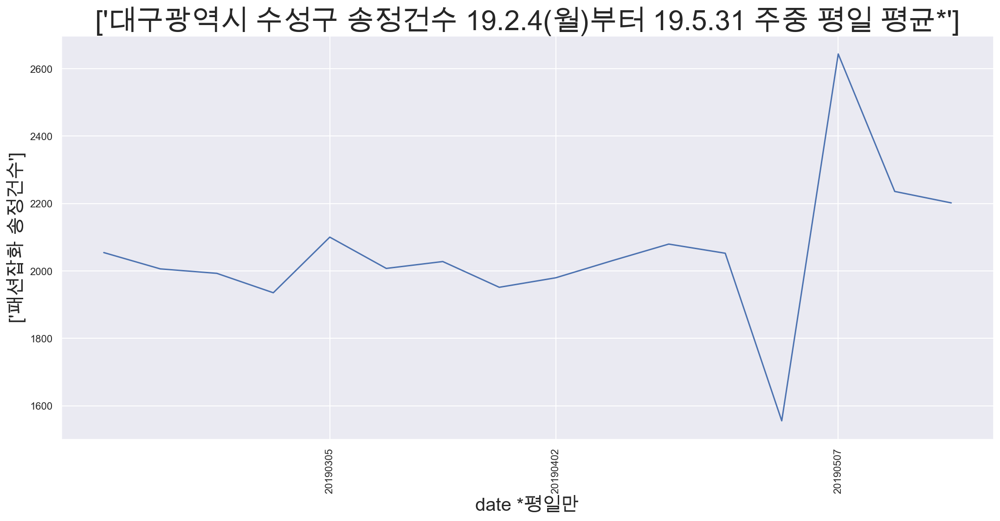

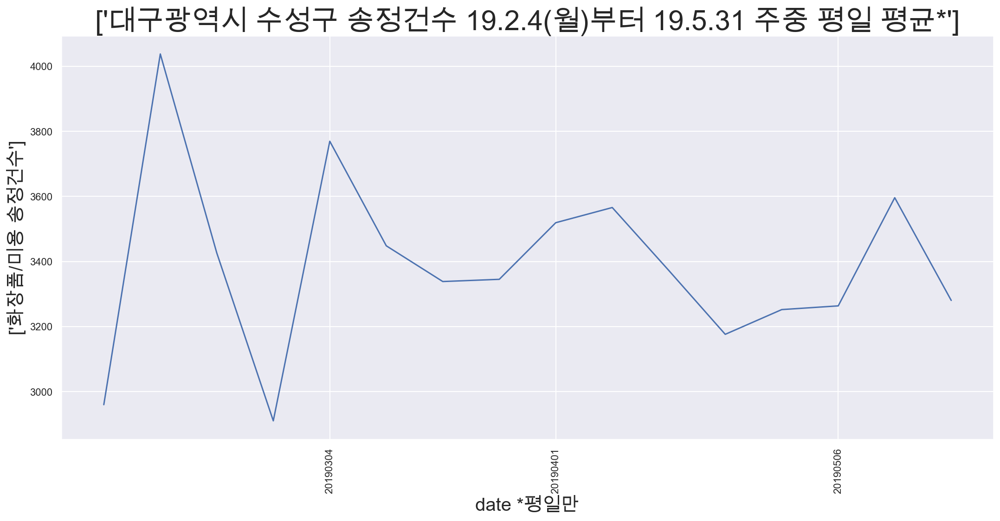

In [385]:
# 19년 구역 & 카테고리별로 나눠줬다

# 구역별
for cd1 in cds:

# 카테고리별    
    for cd2 in (df_19_wd['DL_GD_LCLS_CD'].unique()):
            
            x = df_19_wd.loc[(df_19_wd['CD'] == cd1) & (df_19_wd['DL_GD_LCLS_CD'] == cd2)]
            x.reset_index(inplace=True, drop=True)
            
            mean1 = []
            date1 = []
            
            for idx in range(1, len(x)-5, 5):
                mean1.append(np.mean(x['INVC_CONT'][list(range(idx, idx+5))]))
                date1.append(x.DL_YMD[idx])

            data = {'date1' : date1, 'mean1' : mean1}
            df = pd.DataFrame(data)
            plt.figure(figsize=(18,8))
            plt.plot(df.date1, df.mean1)
            
            plt.xlabel('date *평일만', fontsize=20)
            plt.ylabel(x.DL_GD_LCLS_NM.unique() + ' 송정건수', fontsize=20)
            plt.xticks(rotation=90)
            plt.title(x.CTPV_NM.unique() + " " + x.CTGG_NM.unique() + ' 송정건수 19.2.4(월)부터 19.5.31 주중 평일 평균*', fontsize=30)
            plt.show()
            

In [357]:
y = []
for x in range(0, len(df_19_wd)-5, 5):
    y.append(np.mean(df_19_wd['INVC_CONT'][list(range(x, x+5))]))